In [1]:
#!pip install imageio-ffmpeg

In [2]:
%matplotlib inline
from matplotlib import pyplot as plt
import matplotlib.animation as animation
import matplotlib
matplotlib.rcParams['animation.embed_limit'] = 100

from IPython.display import HTML, Video
import numpy as np
import os
import glob
import cv2
import json
import pytesseract

%load_ext autoreload
%autoreload 2
from app.utils import *

433
(720, 1280, 3) 255


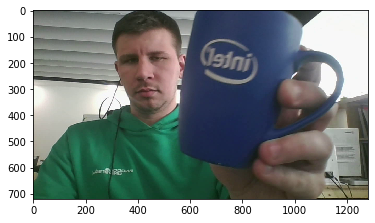

In [3]:
video_fpath = 'data/2018-02-2715_03_24.ogv'

frames = get_all_frames(video_fpath)
print(len(frames))
print(frames[50].shape, frames[10].max())
plt.imshow(frames[50])

In [4]:
#save_video(frames[::25], 'out.mp4')

In [5]:
#for i, f in enumerate(frames[::10]):
#    plt.imsave(f'test_frames/sec_{i:02d}.jpg', f)

In [6]:
cup_colors = [np.array(color, dtype=np.uint8) for color in [[37,47,79], [81,101,133], 
                                                            [61, 79,117], [26,36,54]]] 

[26 36 54]


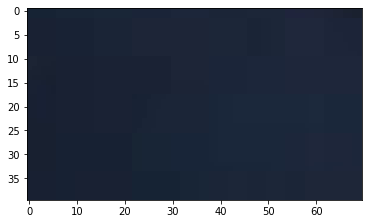

In [7]:
_im = frames[140][110:150, 970:1040]
plt.imshow(_im)
cup_color = _im.mean(axis=(0,1)).astype(np.uint8)
print(cup_color)

# by color

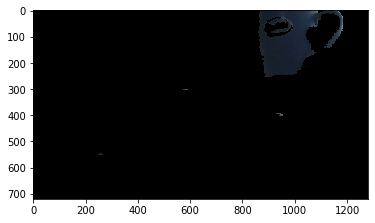

In [8]:
_msk, _cup = select_blue(frames[140], cup_colors)
plt.imshow(_cup)

(864, 0, 304, 256)


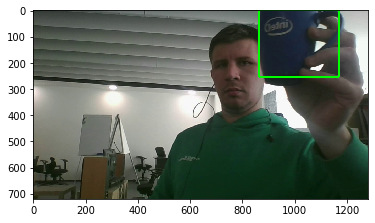

In [9]:
fr = frames[140]
bbox = get_bbox(select_blue(fr, cup_colors)[0])
print(bbox)
bounded = draw_bbox(fr, bbox, show=True)

In [10]:
#def make_gif(frames, out_fpath):
#    resized = [cv2.resize(f, dsize=(300, 200)) for f in frames]
#    imageio.mimsave(out_fpath, resized)
#    
#make_gif(frames, 'out.gif')

# animate results

In [11]:
res_frames, res_boxes = blue_detect(frames)

In [12]:
save_results(video_fpath, res_frames, res_boxes)

data/2018-02-2715_03_24.ogv_out


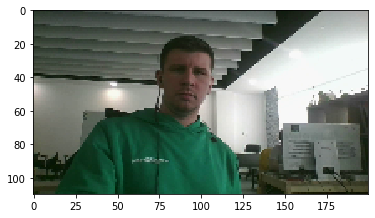

In [13]:
animate(res_frames)

In [14]:
switch_fnames, switch_captions = get_switches(video_fpath)
for f, c in zip(switch_fnames, switch_captions):
    print(f, c)

data/2018-02-2715_03_24.ogv_out/sec_00013.jpg появилась
data/2018-02-2715_03_24.ogv_out/sec_00105.jpg пропала
data/2018-02-2715_03_24.ogv_out/sec_00125.jpg появилась
data/2018-02-2715_03_24.ogv_out/sec_00239.jpg пропала
data/2018-02-2715_03_24.ogv_out/sec_00260.jpg появилась
data/2018-02-2715_03_24.ogv_out/sec_00421.jpg пропала


# yolo

In [16]:
#!wget https://pjreddie.com/media/files/yolov3.weights
!mv yolov3.weights yolo/

In [17]:
net, classes = load_yolo('yolo/')
print(classes)
CUP_CLASS_IDX = classes.index('cup')
print(f'cup class_idx = {CUP_CLASS_IDX}')

['person', 'bicycle', 'car', 'motorbike', 'aeroplane', 'bus', 'train', 'truck', 'boat', 'traffic light', 'fire hydrant', 'stop sign', 'parking meter', 'bench', 'bird', 'cat', 'dog', 'horse', 'sheep', 'cow', 'elephant', 'bear', 'zebra', 'giraffe', 'backpack', 'umbrella', 'handbag', 'tie', 'suitcase', 'frisbee', 'skis', 'snowboard', 'sports ball', 'kite', 'baseball bat', 'baseball glove', 'skateboard', 'surfboard', 'tennis racket', 'bottle', 'wine glass', 'cup', 'fork', 'knife', 'spoon', 'bowl', 'banana', 'apple', 'sandwich', 'orange', 'broccoli', 'carrot', 'hot dog', 'pizza', 'donut', 'cake', 'chair', 'sofa', 'pottedplant', 'bed', 'diningtable', 'toilet', 'tvmonitor', 'laptop', 'mouse', 'remote', 'keyboard', 'cell phone', 'microwave', 'oven', 'toaster', 'sink', 'refrigerator', 'book', 'clock', 'vase', 'scissors', 'teddy bear', 'hair drier', 'toothbrush']
cup class_idx = 41


In [18]:
blob, _hw = prepare_input([frames[140], frames[141]])
H, W = _hw[0]
print(blob.shape)

(2, 3, 416, 416)


In [19]:
outs, _hw = predict(net, [frames[140], frames[141]])
print(len(outs))
print([o.shape for o in outs])

3
[(2, 507, 85), (2, 2028, 85), (2, 8112, 85)]


[[566, 0, 657, 671], [833, 2, 363, 286]]


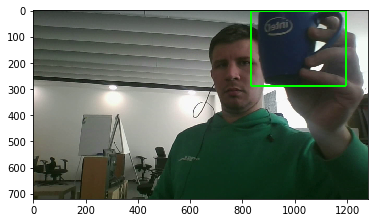

In [20]:
find_bbox(slice_outs(outs, 0), H, W, CUP_CLASS_IDX)
yolocup_detector = YoloDetector(net, class_idx=CUP_CLASS_IDX)
_res_fr, _res_bb = yolocup_detector([frames[50], frames[140]])
print(_res_bb)
plt.imshow(_res_fr[1])

In [21]:
res_frames, res_bboxes = yolocup_detector(frames[:15])

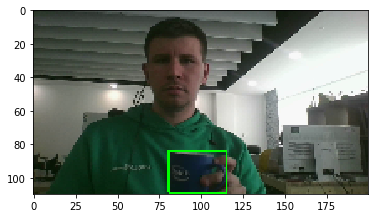

In [22]:
animate(res_frames)

# test script

In [3]:
!python3 script1.py -i 2018-02-2715_03_24.ogv

Input file is " 2018-02-2715_03_24.ogv "
Output file is " out.m4v "
Killed
